<a href="https://colab.research.google.com/github/AzisilhamK463/UAS_PCVK/blob/main/Tubes_PCVK.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tugas Besar PCVK

In [23]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# Pembuatan Model CNN,Train Model dan Save Model

In [24]:
import os
import imutils
import cv2 as cv
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from imutils.contours import sort_contours
from tensorflow.keras import layers, models
from google.colab.patches import cv2_imshow
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from keras.preprocessing.image import ImageDataGenerator

In [25]:
class myCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs = {}):
    if (logs.get('accuracy') > 0.99):
      print('\nAkurasi mencapai 99%')
      self.model.stop_training = True

callbacks = myCallback()

In [97]:
def load_data(folder_path, target_size=(32, 32)):
    data = []
    labels = []
    label_dict = {}
    label_counter = 0

    for label in os.listdir(folder_path):
        label_dict[label_counter] = label
        label_path = os.path.join(folder_path, label)
        for image_file in os.listdir(label_path):
            image_path = os.path.join(label_path, image_file)

            try:
                # Coba membaca gambar
                image = cv.imread(image_path, cv.IMREAD_GRAYSCALE)

                if image is not None and not image.size == 0:
                    # Resize gambar ke dimensi yang diinginkan
                    image = cv.resize(image, target_size)
                    data.append(image)
                    labels.append(label_counter)
            except Exception as e:
                print(f"Error processing image {image_path}: {str(e)}")

        label_counter += 1

    return np.array(data), np.array(labels), label_dict


def train_ocr_model(folder_path, save_path = "final_model.h5"):
    # Memuat data dari folder huruf
    data, labels, label_dict = load_data(folder_path)

    # Membagi data menjadi train dan test set
    X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

    # Mengonversi label menjadi one-hot encoding
    y_train = to_categorical(y_train, num_classes=len(label_dict))
    y_test = to_categorical(y_test, num_classes=len(label_dict))

    # Membangun model CNN
    model = models.Sequential()
    model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(32, 32, 1)))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dense(128, activation='relu'))
    model.add(layers.Dense(len(label_dict), activation='softmax'))  # Jumlah kelas sesuai dengan jumlah huruf

    # Kompilasi model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

    # Praproses data untuk format yang diterima oleh model
    X_train = X_train.reshape((X_train.shape[0], 32, 32, 1)).astype('float32') / 255
    X_test = X_test.reshape((X_test.shape[0], 32, 32, 1)).astype('float32') / 255


    # Augmentasi data menggunakan ImageDataGenerator
    datagen = ImageDataGenerator(rotation_range=10, zoom_range=0.1, width_shift_range=0.1, height_shift_range=0.1)
    datagen.fit(X_train)

    # Pelatihan model
    history = model.fit(datagen.flow(X_train, y_train, batch_size=32), epochs=30, validation_data=(X_test, y_test), callbacks = [callbacks])

    # Evaluasi model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Simpan model
    model.save(save_path)
    print(f'Model saved to {save_path}')

In [98]:
train_ocr_model("/content/gdrive/MyDrive/PCVK_UAS/dataset/training_dataset")

Epoch 1/30
35/35 [==============================] - 3s 25ms/step - loss: 3.3509 - accuracy: 0.0904 - val_loss: 3.2592 - val_accuracy: 0.1095
Epoch 2/30
35/35 [==============================] - 0s 13ms/step - loss: 3.0050 - accuracy: 0.1753 - val_loss: 2.5962 - val_accuracy: 0.3905
Epoch 3/30
35/35 [==============================] - 0s 13ms/step - loss: 2.2863 - accuracy: 0.4356 - val_loss: 1.7160 - val_accuracy: 0.6058
Epoch 4/30
35/35 [==============================] - 0s 13ms/step - loss: 1.6821 - accuracy: 0.5516 - val_loss: 1.2501 - val_accuracy: 0.6752
Epoch 5/30
35/35 [==============================] - 0s 13ms/step - loss: 1.2262 - accuracy: 0.6594 - val_loss: 0.8793 - val_accuracy: 0.7774
Epoch 6/30
35/35 [==============================] - 0s 13ms/step - loss: 0.9906 - accuracy: 0.7114 - val_loss: 0.7094 - val_accuracy: 0.8175
Epoch 7/30
35/35 [==============================] - 0s 13ms/step - loss: 0.7824 - accuracy: 0.7763 - val_loss: 0.5050 - val_accuracy: 0.9015
Epoch 8/30
35

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


# Load Model

In [99]:
# Load Model.

load_network = load_model('/content/final_model.h5')
load_network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 30, 30, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 15, 15, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                            
                                                                 
 flatten (Flatten)           (None, 2304)              0         
                                                                 
 dense (Dense)               (None, 128)               2

# Preprosessing Citra dan Recognition Karakter

In [100]:
digits = '0I23456789'
letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
char_list = digits + letters
char_list = [ch for ch in char_list]

In [101]:
# Fungsi preprocessing citra
def preprocess_img(img):
  blur = cv.GaussianBlur(img, (5,5), .5)
  sharpened = cv.addWeighted(img, 1.5, blur,-0.5,0)
  gray = cv.cvtColor(sharpened, cv.COLOR_BGR2GRAY)
  _, thresh = cv.threshold(gray, 128, 255, cv.THRESH_BINARY_INV)
  kernel = np.ones((1, 1), np.uint8)
  closing = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel, iterations=1)
  result = cv.dilate(closing, kernel, iterations=4)

  return gray, result

# Define function find contours for contour detection
def find_contours(img):
    conts = cv.findContours(img, cv.RETR_TREE, cv.CHAIN_APPROX_NONE)
    conts = imutils.grab_contours(conts)
    conts = sort_contours(conts, method='left-to-right')[0]
    return conts

# Function to extract roi
def extract_roi(img, x, y, w, h):
    roi = img[y:y+h, x:x+w]
    return roi

# Function for thresholding
def thresholding(img):
    thresh = cv.threshold(img, 0, 255, cv.THRESH_BINARY_INV + cv.THRESH_OTSU)[1]
    return thresh

# Function for normalization
def normalization(img):
    img = img.astype('float32') / 255.0
    img = np.expand_dims(img, axis=-1)
    return img

# Function for resizing image
def resize_img(img, w, h):
    target_size = (32, 32)

    if w > h:
        new_h = int(target_size[1] * h / w)
        resized = cv.resize(img, (target_size[0], new_h))
    else:
        new_w = int(target_size[0] * w / h)
        resized = cv.resize(img, (new_w, target_size[1]))

    (h, w) = resized.shape
    dX = int(max(0, target_size[0] - w) / 2.0)
    dY = int(max(0, target_size[1] - h) / 2.0)

    filled = cv.copyMakeBorder(resized, top=dY, bottom=dY, right=dX, left=dX, borderType=cv.BORDER_CONSTANT, value=(0, 0, 0))
    filled = cv.resize(filled, target_size)

    return filled

# Function to process box
def process_box(gray, x, y, w, h):
    roi = extract_roi(gray, x, y, w, h)
    thresh = thresholding(roi)
    resized = resize_img(thresh, w, h)
    normalized = normalization(resized)

    # show result
    cv2_imshow(resized)

    return (normalized, (x, y, w, h))

# Function to process KTM image
def process_ktm_image(image, model, char_list):
    gray_ktm, prep_ktm = preprocess_img(image)
    conts_border = find_contours(prep_ktm)

    # Setup min/max width/hight for char
    min_w, max_w = 5, 160
    min_h, max_h = 36, 140
    img_with_contour_ktm = image.copy()
    for c in conts_border:
        (x, y, w, h) = cv.boundingRect(c)
        if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h):
          roi = gray_ktm[y:y+h, x:x+w]
          thresh = cv.threshold(roi, 0, 255, cv.THRESH_BINARY_INV + cv.THRESH_OTSU)[1]
          cv.rectangle(img_with_contour_ktm, (x, y), (x + w, y + h), (255, 0, 0), 3)
          # cv2_imshow(thresh) # check

    cv2_imshow(img_with_contour_ktm)

    # Extract and process characters
    detected_char = []
    for c in conts_border:
        (x, y, w, h) = cv.boundingRect(c)
        detected_char.append(process_box(gray_ktm, x, y, w, h))

    # Get all char pixel
    pixels = np.array([px[0] for px in detected_char], dtype='float32')

    # Get all box for detected char
    boxes = [box[1] for box in detected_char]

    # Predict characters
    preds = model.predict(pixels)

    img_copy2 = image.copy()
    for (pred, (x, y, w, h)) in zip(preds, boxes):
        i = np.argmax(pred)
        char_detected = char_list[i]
        cv.rectangle(img_copy2, (x, y), (x+w, y+h), (255,0,0), 2)
        cv.putText(img_copy2, char_detected, (x - 10, y - 10), cv.FONT_HERSHEY_COMPLEX, 1, (0,0,255), 2)

    cv2_imshow(img_copy2)

# Test Citra KTM 1

Jumlah Piksel Baris: 3456
Jumlah Piksel Kolom: 4608


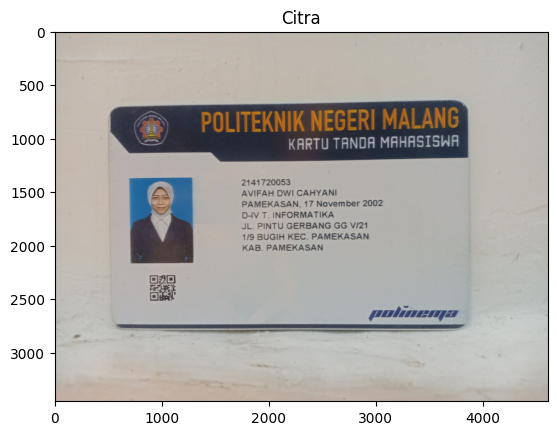

In [102]:
ktm_image_path = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3E_2141720053_1 - Avifah Dwi Cahyani.jpg')
height, width = ktm_image_path.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

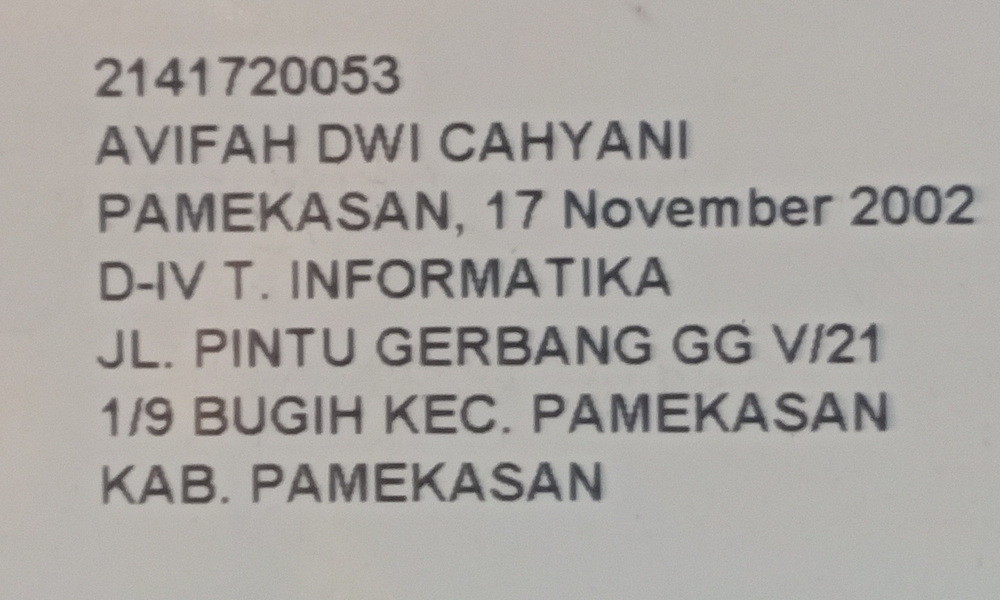

In [103]:
ktm_crop = ktm_image_path[1300:2200,1600:3100]
cv2_imshow(ktm_crop)

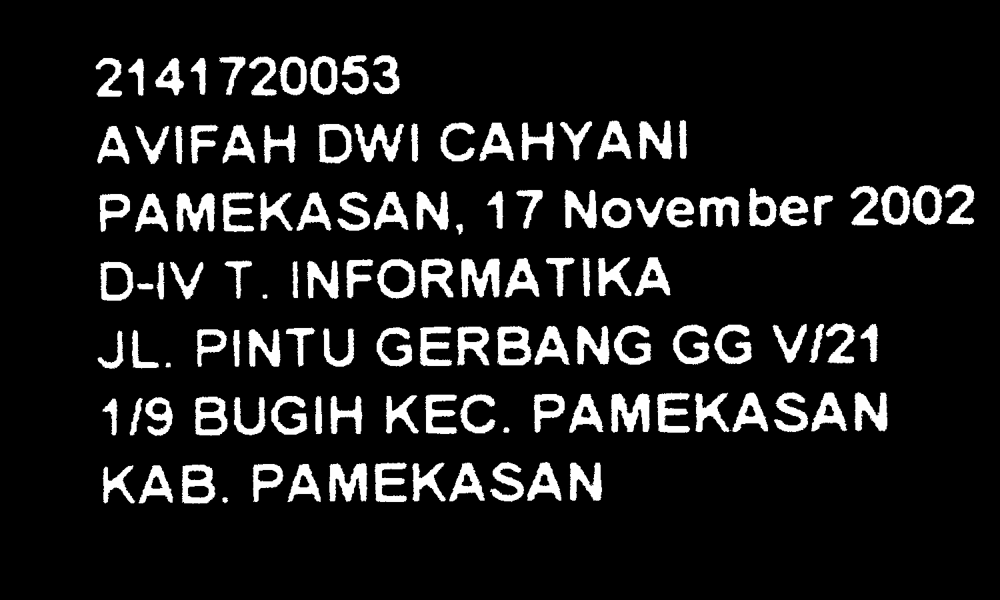

In [104]:
gray, prepro_ktm = preprocess_img(ktm_crop)
cv2_imshow(prepro_ktm)

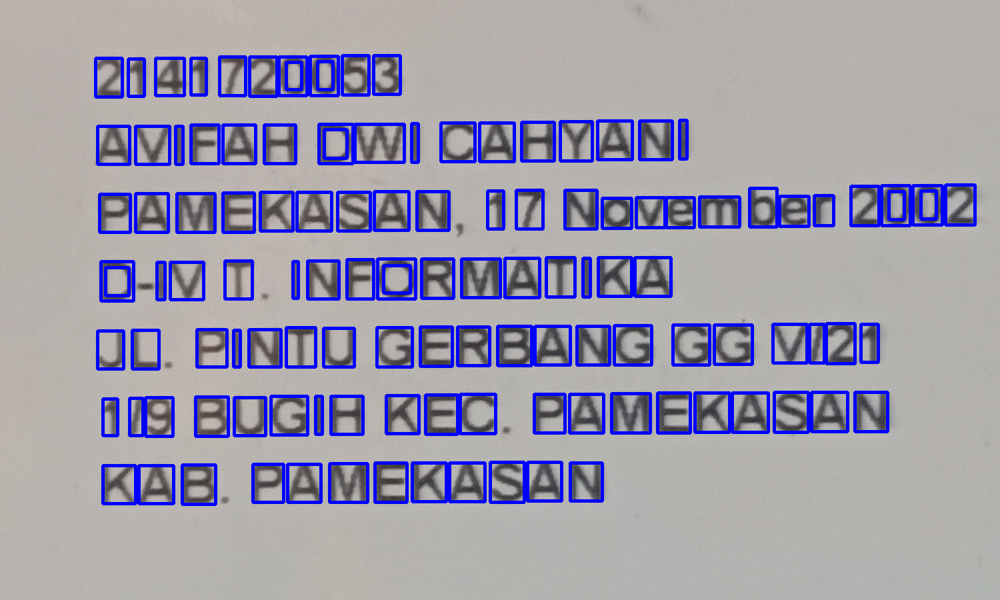

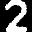

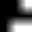

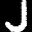

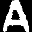

...

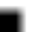

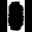

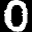

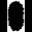

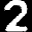

6/6 [==============================] - 0s 4ms/step


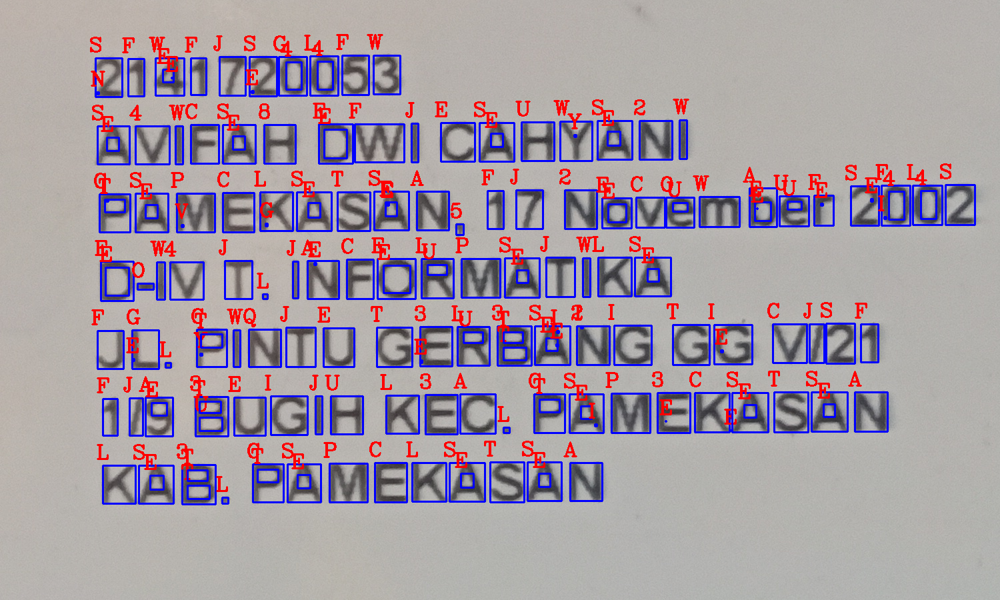

In [105]:
process_ktm_image(ktm_crop, load_network, char_list)

# Test Citra KTM 2

Jumlah Piksel Baris: 3456
Jumlah Piksel Kolom: 4608


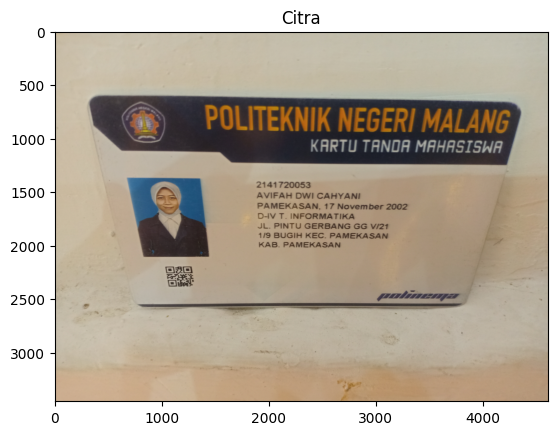

In [106]:
ktm_image_path2 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3E_2141720053_2 - Avifah Dwi Cahyani.jpg')
height, width = ktm_image_path2.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path2, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

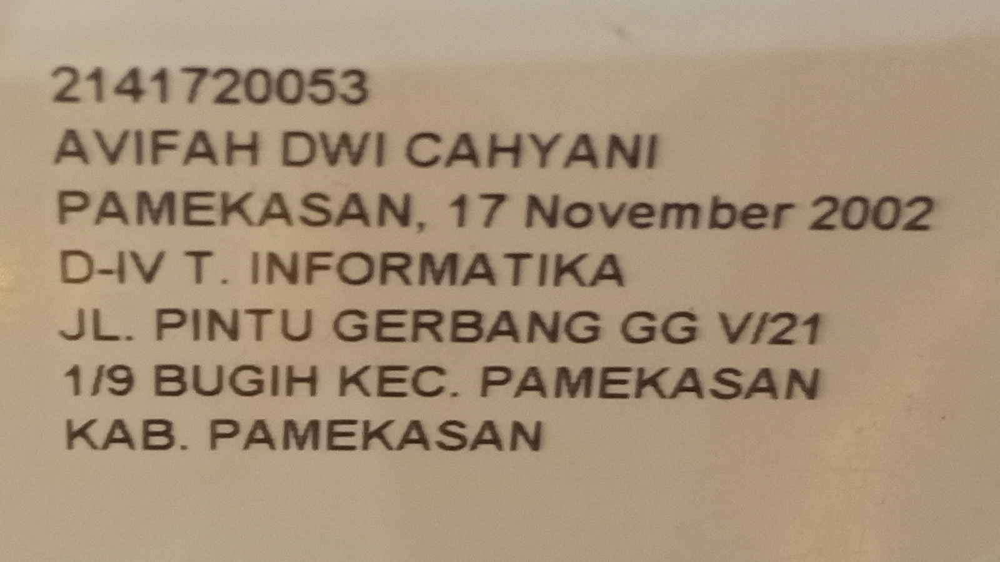

In [107]:
ktm_crop2 = ktm_image_path2[1300:2200,1800:3400]
cv2_imshow(ktm_crop2)

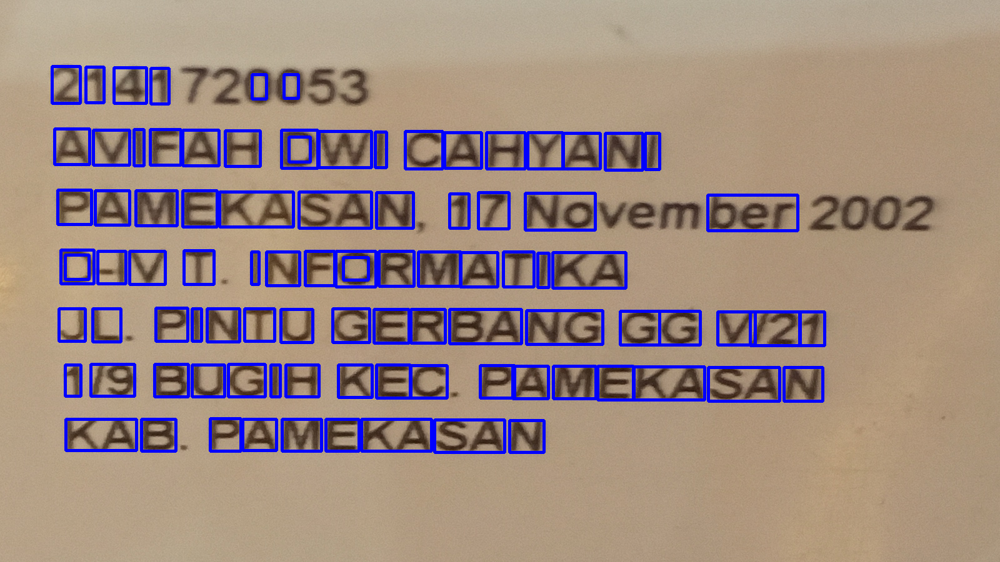

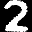

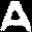

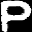

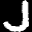

...

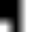

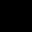

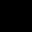

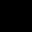

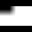

12/12 [==============================] - 0s 8ms/step


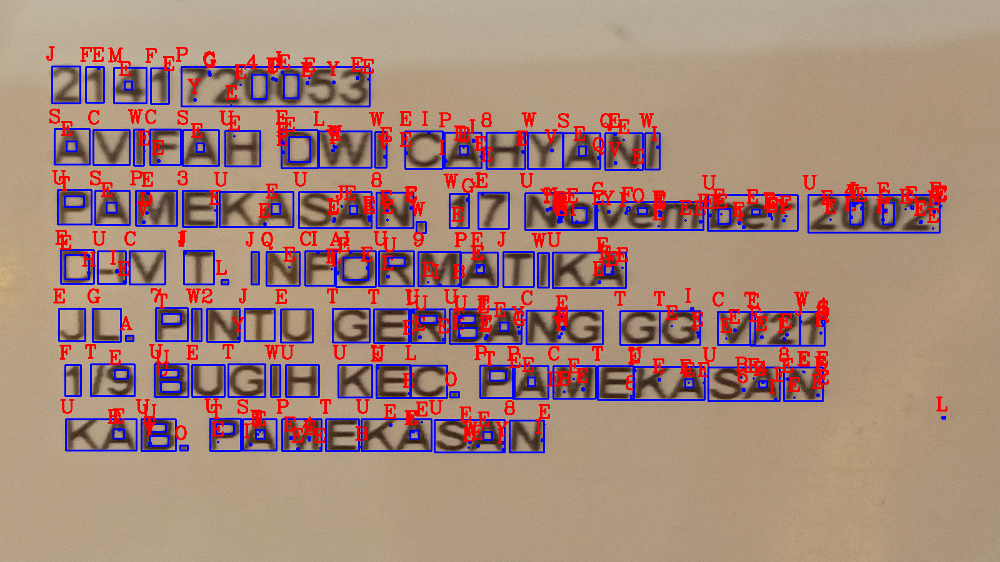

In [108]:
process_ktm_image(ktm_crop2, load_network, char_list)

# Test Citra KTM 3

Jumlah Piksel Baris: 3456
Jumlah Piksel Kolom: 4608


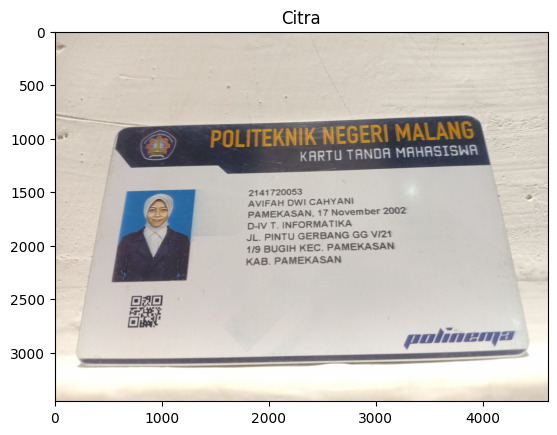

In [109]:
ktm_image_path3 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3E_2141720053_3 - Avifah Dwi Cahyani.jpg')
height, width = ktm_image_path3.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path3, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

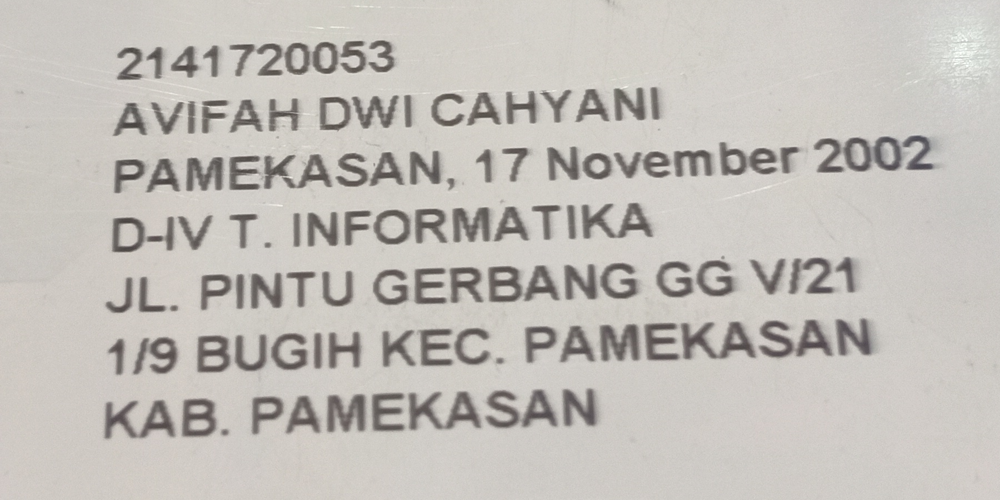

In [110]:
ktm_crop3 = ktm_image_path3[1400:2300,1600:3400]
cv2_imshow(ktm_crop3)

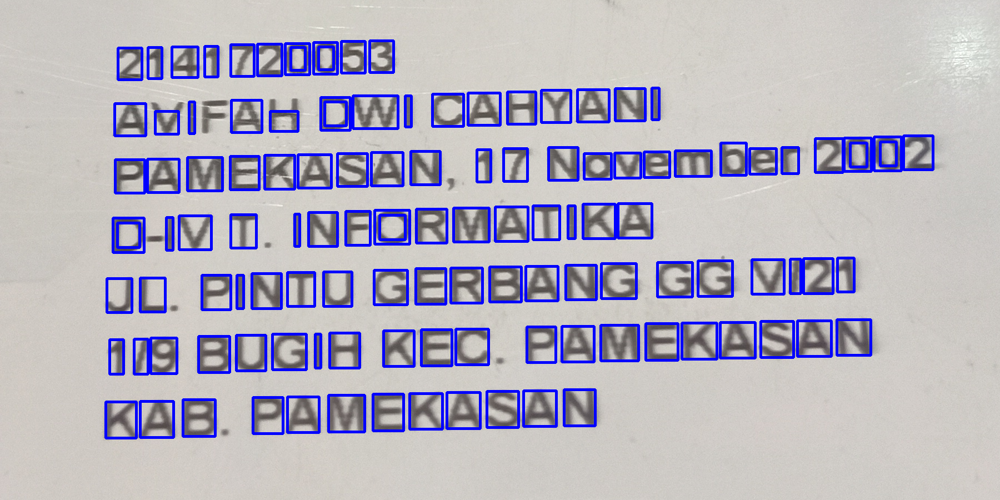

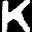

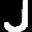

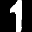

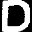

...

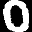

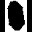

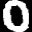

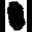

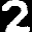

7/7 [==============================] - 0s 3ms/step


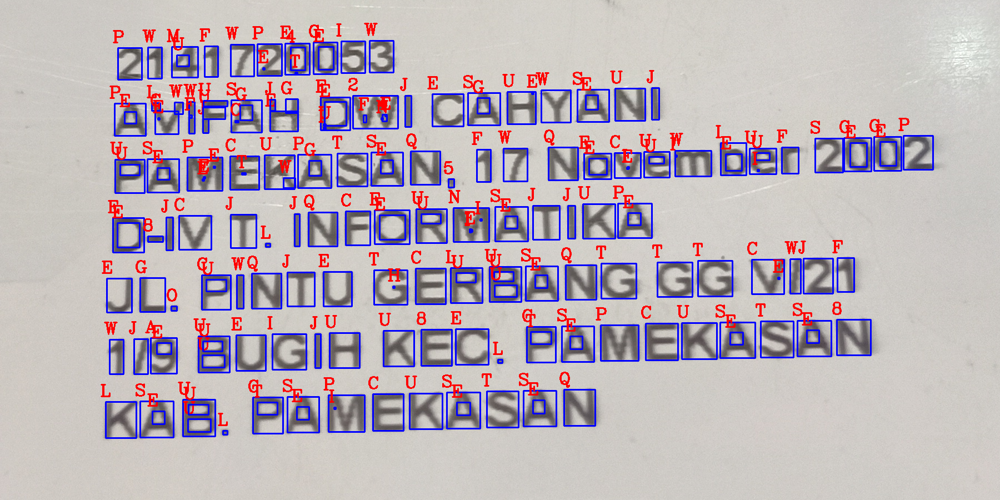

In [111]:
process_ktm_image(ktm_crop3, load_network, char_list)

# Test Citra KTM 4

Jumlah Piksel Baris: 3456
Jumlah Piksel Kolom: 4608


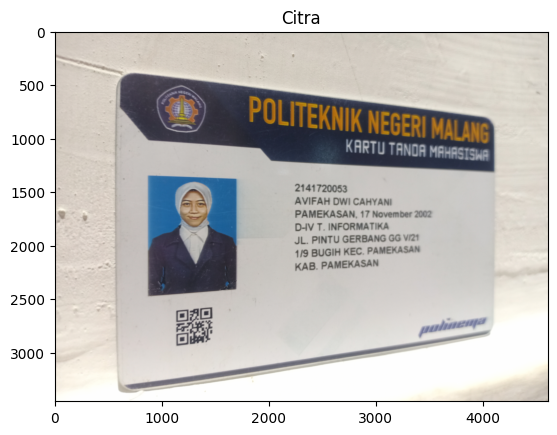

In [112]:
ktm_image_path4 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3E_2141720053_4 - Avifah Dwi Cahyani.jpg')
height, width = ktm_image_path4.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path4, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

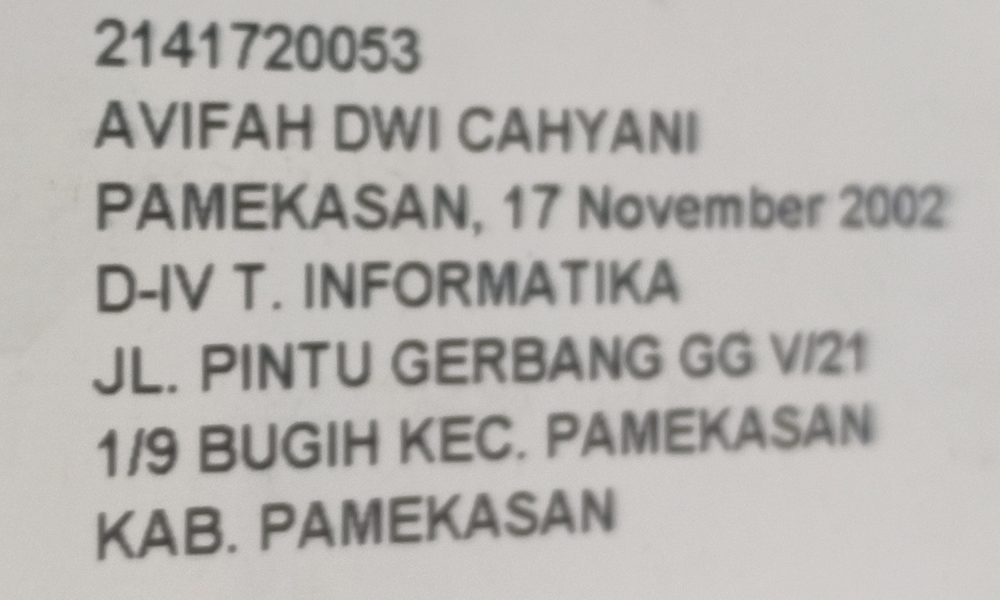

In [113]:
ktm_crop4 = ktm_image_path4[1400:2300,2100:3600]
cv2_imshow(ktm_crop4)

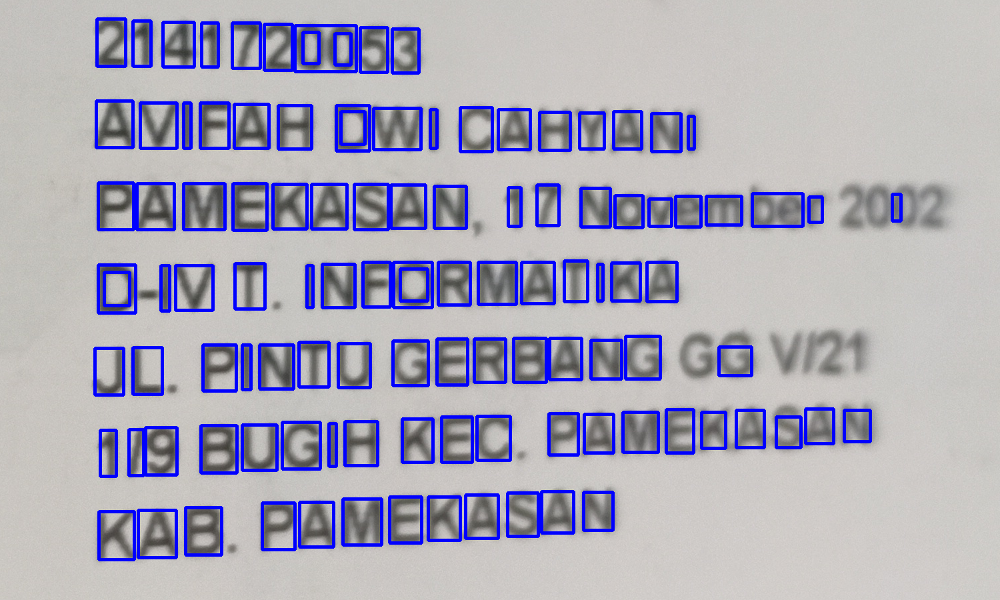

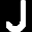

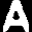

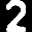

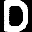

...

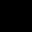

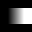

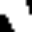

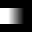

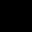

9/9 [==============================] - 0s 3ms/step


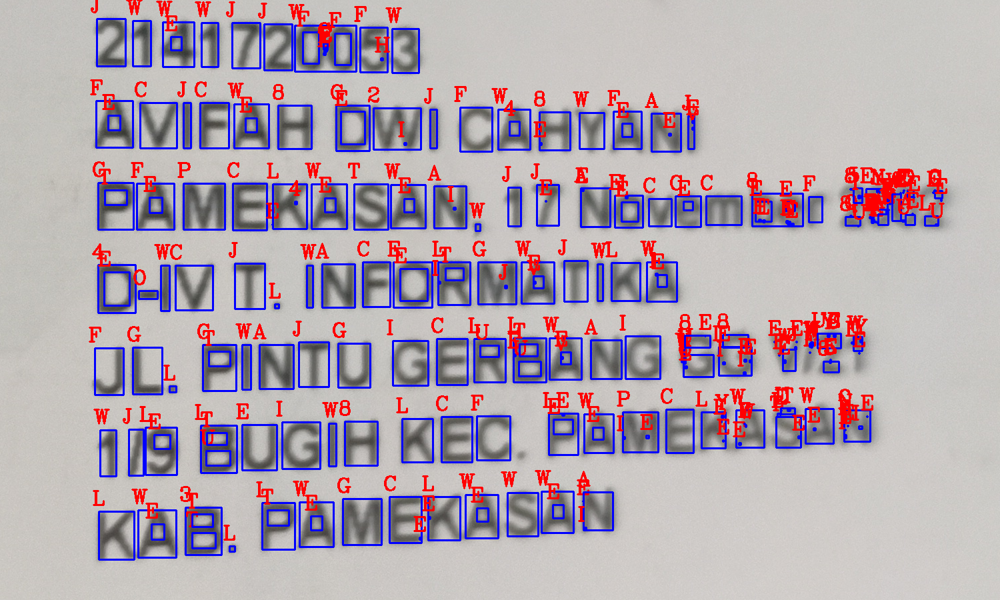

In [114]:
process_ktm_image(ktm_crop4, load_network, char_list)

# Test Citra KTM 5

Jumlah Piksel Baris: 3456
Jumlah Piksel Kolom: 4608


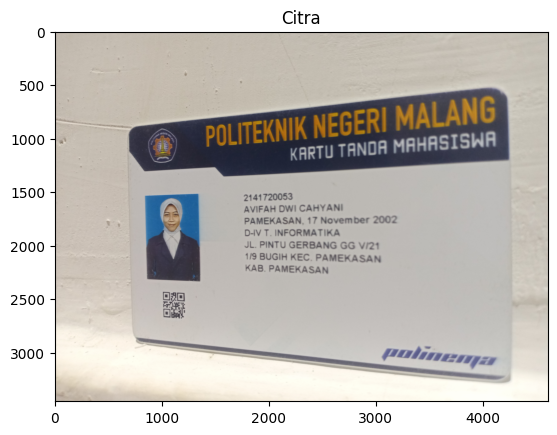

In [115]:
ktm_image_path5 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3E_2141720053_5 - Avifah Dwi Cahyani.jpg')
height, width = ktm_image_path5.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path5, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

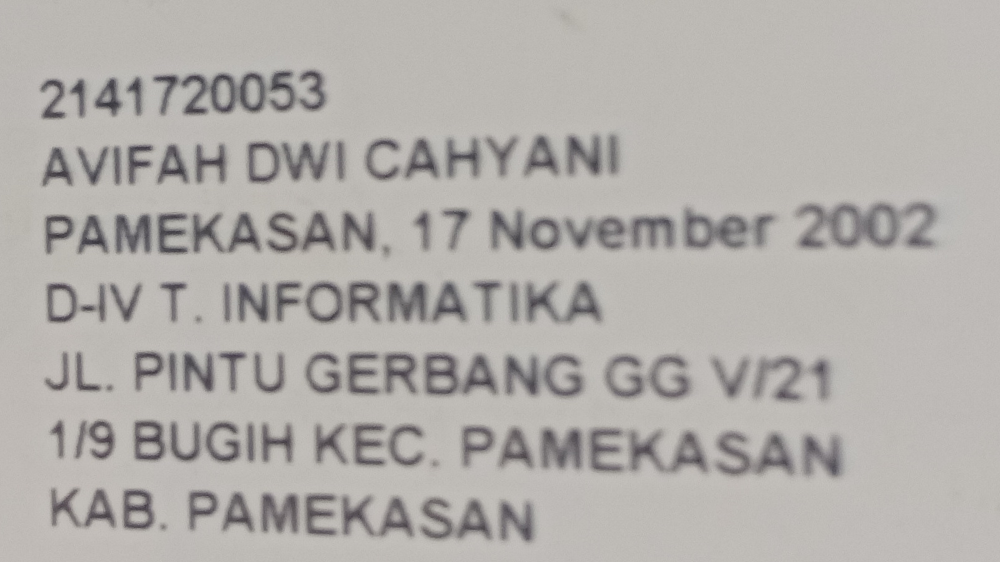

In [118]:
ktm_crop5 = ktm_image_path5[1400:2300,1700:3300]
cv2_imshow(ktm_crop5)

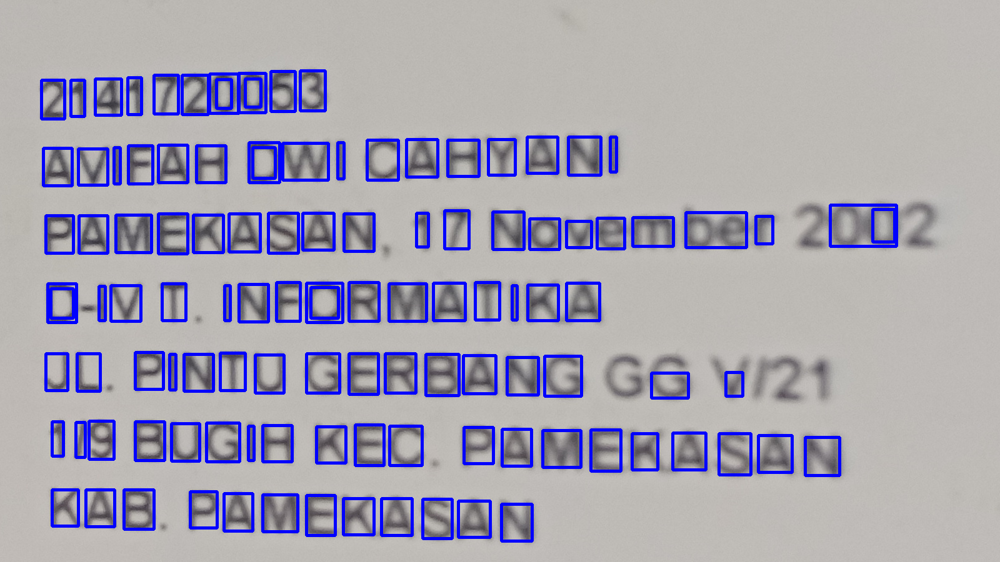

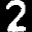

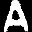

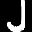

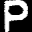

...

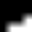

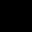

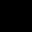

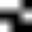

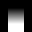

11/11 [==============================] - 0s 20ms/step


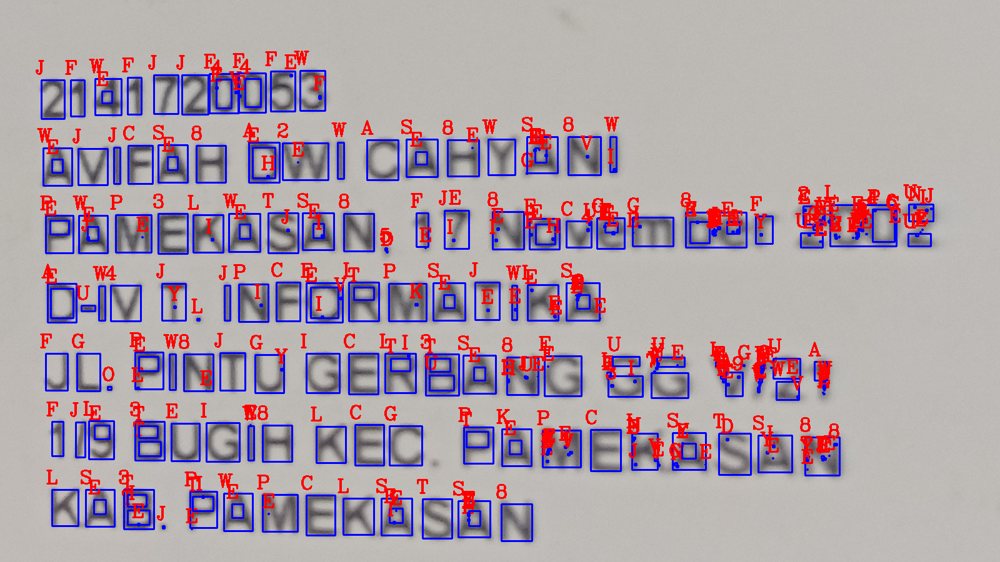

In [119]:
process_ktm_image(ktm_crop5, load_network, char_list)

# Test Citra KTM 6

Jumlah Piksel Baris: 1280
Jumlah Piksel Kolom: 960


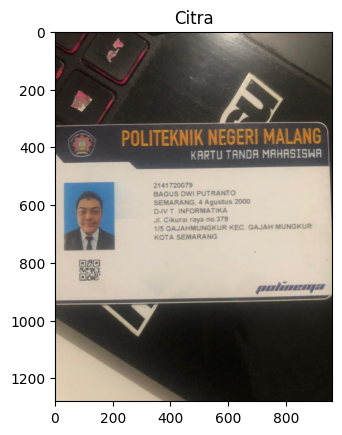

In [120]:
ktm_image_path6 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3G2141720079_1 - Badzlin Maladzi.jpg')
height, width = ktm_image_path6.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path6, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

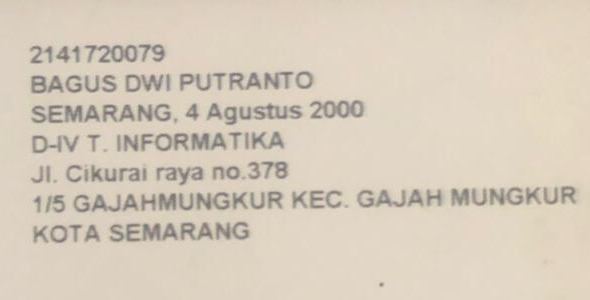

In [129]:
ktm_crop6 = ktm_image_path6[480:780,310:900]
cv2_imshow(ktm_crop6)

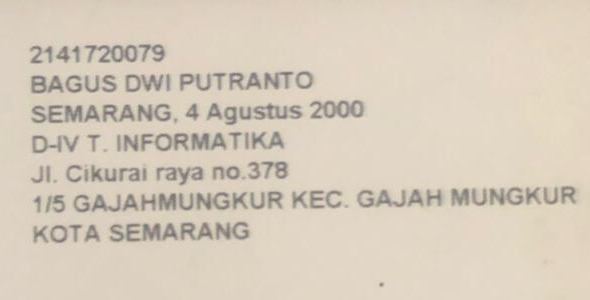

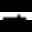

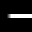

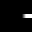

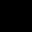

...

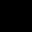

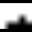

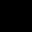

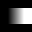

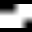

9/9 [==============================] - 0s 23ms/step


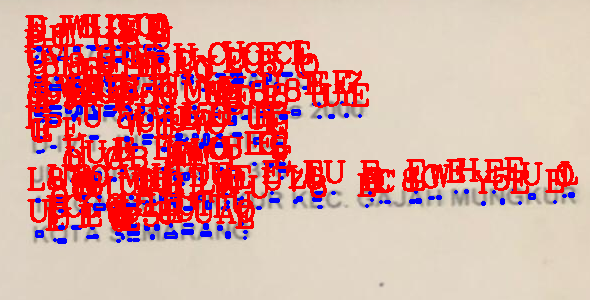

In [130]:
process_ktm_image(ktm_crop6, load_network, char_list)

# Test Citra KTM 7

Jumlah Piksel Baris: 1280
Jumlah Piksel Kolom: 960


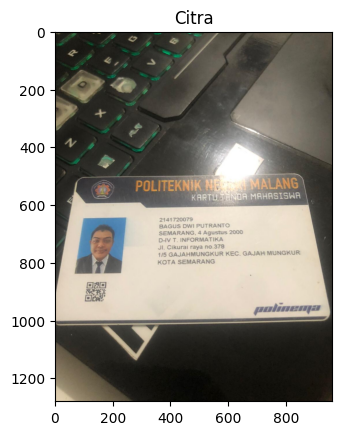

In [132]:
ktm_image_path7 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3G_2141720079_2 - Badzlin Maladzi.jpg')
height, width = ktm_image_path7.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path7, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

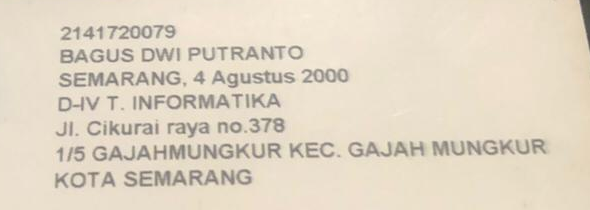

In [135]:
ktm_crop7 = ktm_image_path7[620:830,300:890]
cv2_imshow(ktm_crop7)

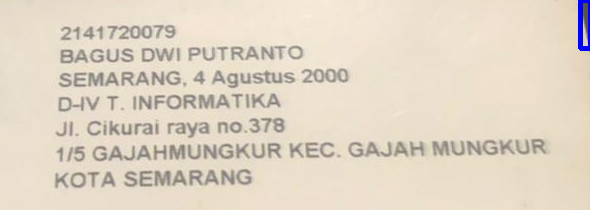

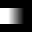

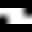

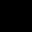

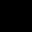

...

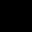

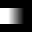

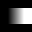

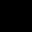

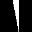

6/6 [==============================] - 0s 29ms/step


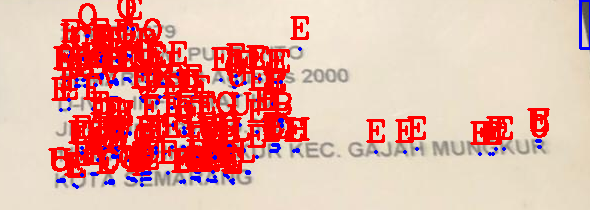

In [136]:
process_ktm_image(ktm_crop7, load_network, char_list)

# Test Citra KTM 8



Jumlah Piksel Baris: 1280
Jumlah Piksel Kolom: 960


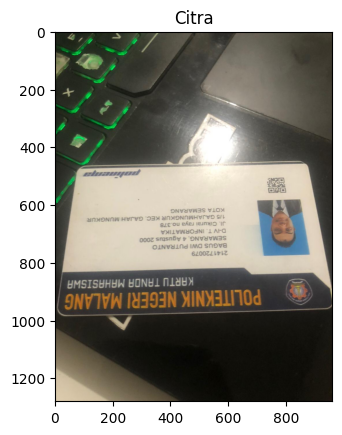

In [137]:
ktm_image_path8 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3G_2141720079_3 - Badzlin Maladzi.jpg')
height, width = ktm_image_path8.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path8, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

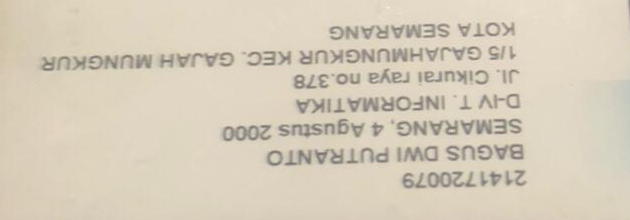

In [139]:
ktm_crop8 = ktm_image_path8[590:810,70:700]
cv2_imshow(ktm_crop8)

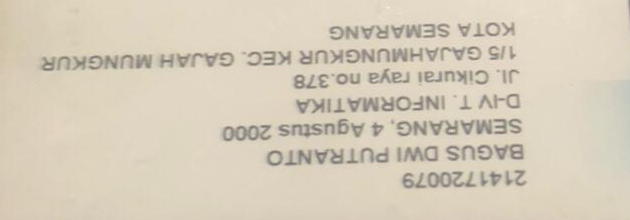

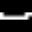

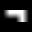

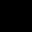

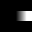

...

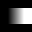

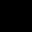

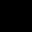

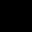

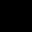

7/7 [==============================] - 0s 30ms/step


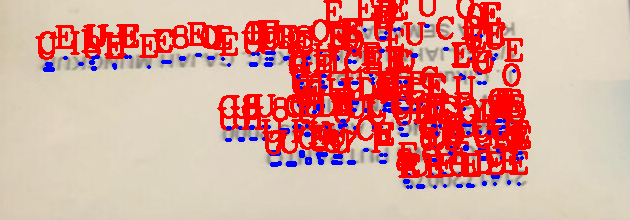

In [140]:
process_ktm_image(ktm_crop8, load_network, char_list)

# Test Citra KTM 9

Jumlah Piksel Baris: 1280
Jumlah Piksel Kolom: 960


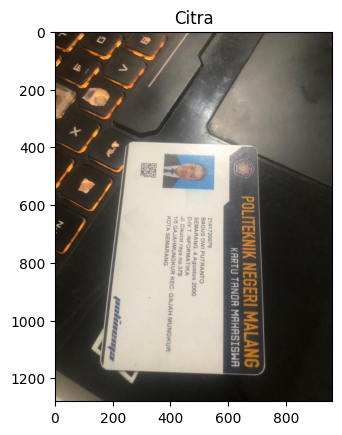

In [141]:
ktm_image_path9 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3G_2141720079_4 - Badzlin Maladzi.jpg')
height, width = ktm_image_path9.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path9, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

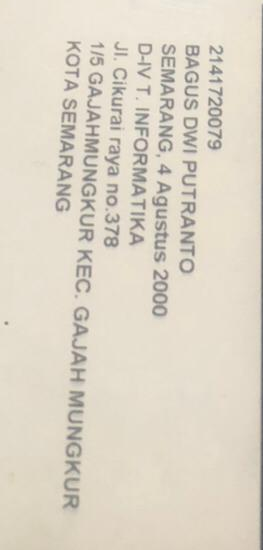

In [149]:
ktm_crop9 = ktm_image_path9[600:1150,320:583]
cv2_imshow(ktm_crop9)

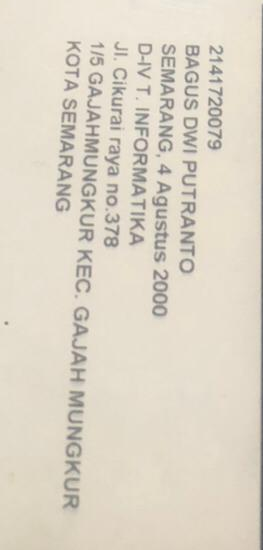

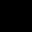

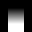

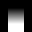

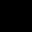

...

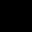

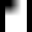

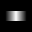

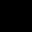

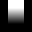

error: ignored

In [150]:
process_ktm_image(ktm_crop9, load_network, char_list)

# Test Citra KTM 10

Jumlah Piksel Baris: 1280
Jumlah Piksel Kolom: 960


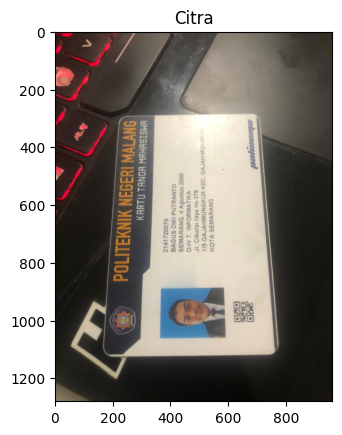

In [153]:
ktm_image_path10 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3G_2141720079_5 - Badzlin Maladzi.jpg')
height, width = ktm_image_path10.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path10, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

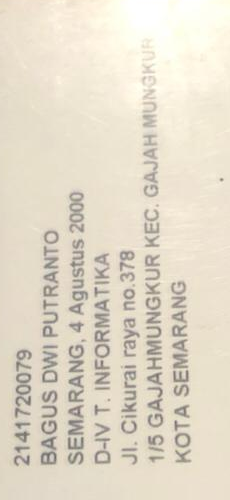

In [155]:
ktm_crop10 = ktm_image_path10[300:800,360:590]
cv2_imshow(ktm_crop10)

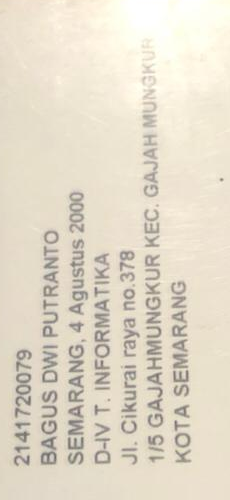

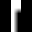

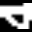

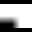

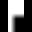

...

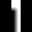

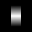

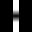

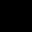

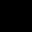

5/5 [==============================] - 0s 3ms/step


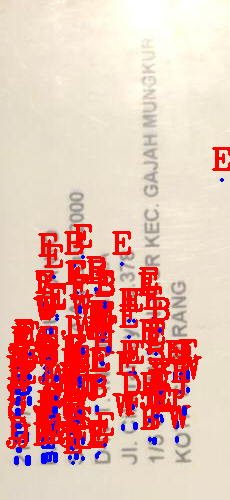

In [156]:
process_ktm_image(ktm_crop10, load_network, char_list)

# Test Citra KTM 11

Jumlah Piksel Baris: 932
Jumlah Piksel Kolom: 1600


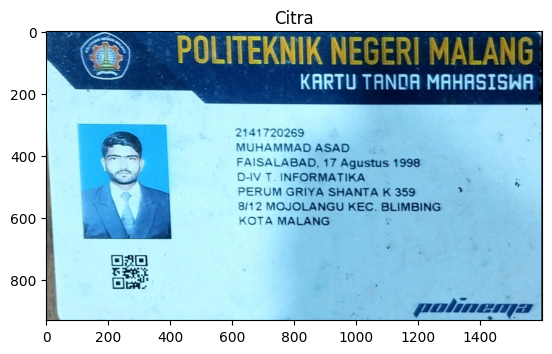

In [157]:
ktm_image_path11 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3I_2141720269_1 - Muhammad Asad.jpeg')
height, width = ktm_image_path11.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path11, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

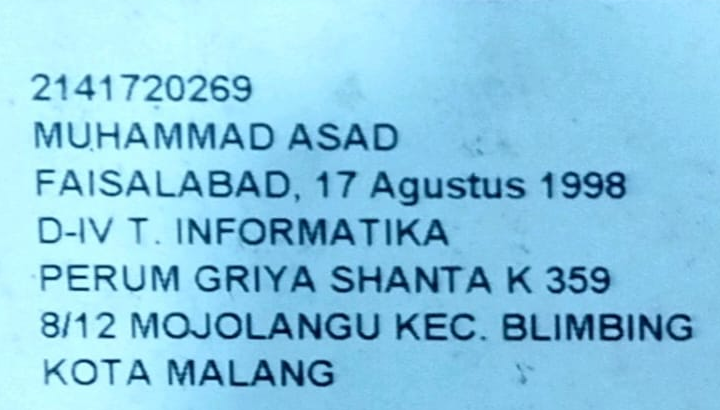

In [159]:
ktm_crop11 = ktm_image_path11[240:650,580:1300]
cv2_imshow(ktm_crop11)

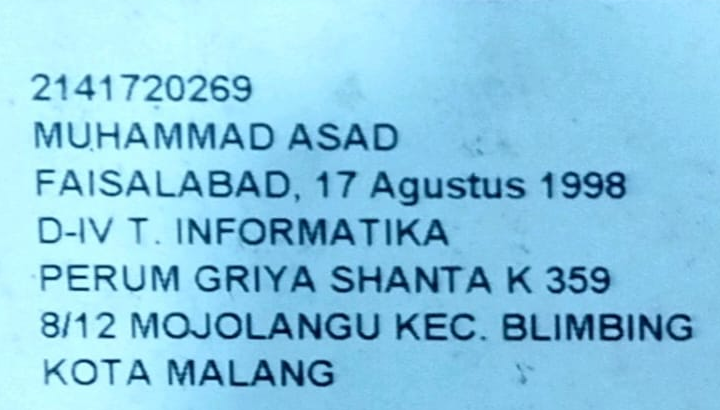

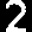

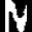

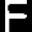

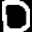

...

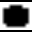

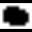

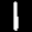

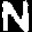

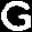

6/6 [==============================] - 0s 4ms/step


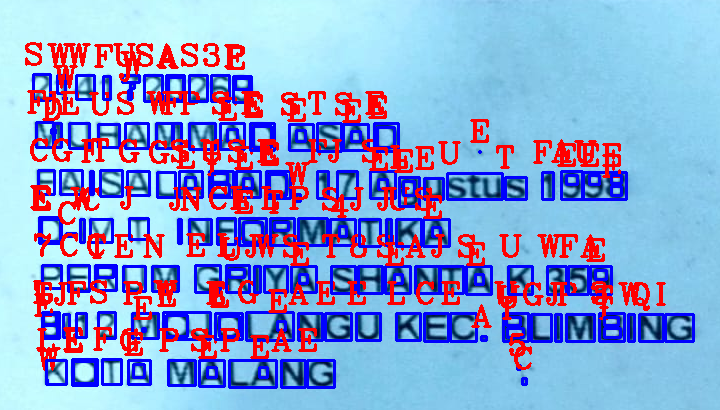

In [160]:
process_ktm_image(ktm_crop11, load_network, char_list)

# Test Citra KTM 12

Jumlah Piksel Baris: 1599
Jumlah Piksel Kolom: 1014


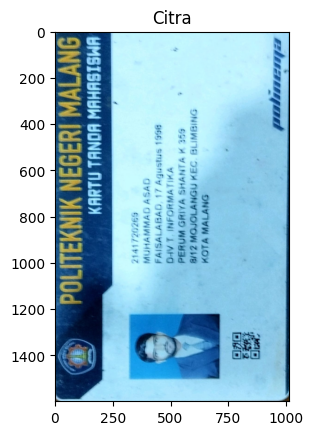

In [161]:
ktm_image_path12 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3I_2141720269_2 - Muhammad Asad.jpeg')
height, width = ktm_image_path12.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path12, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

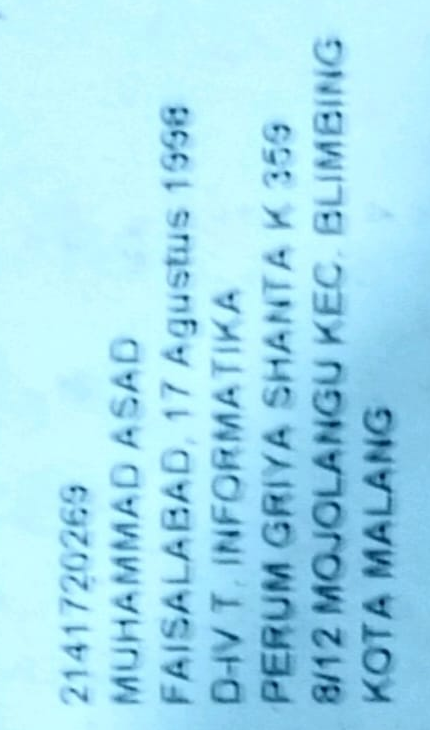

In [162]:
ktm_crop12 = ktm_image_path12[300:1030,270:700]
cv2_imshow(ktm_crop12)

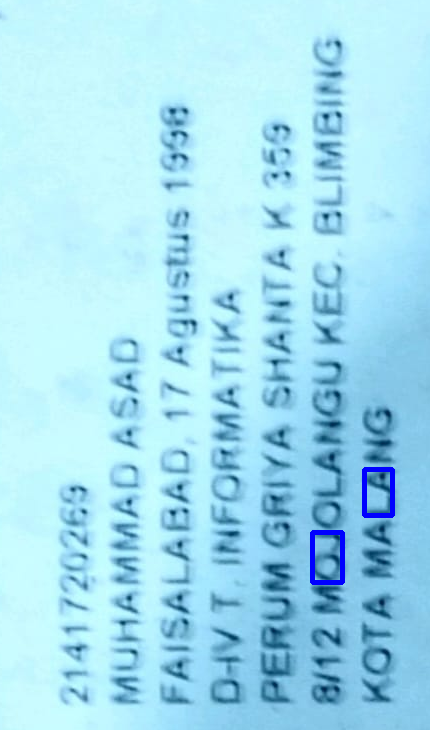

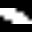

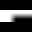

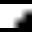

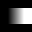

...

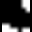

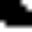

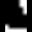

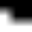

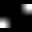

7/7 [==============================] - 0s 22ms/step


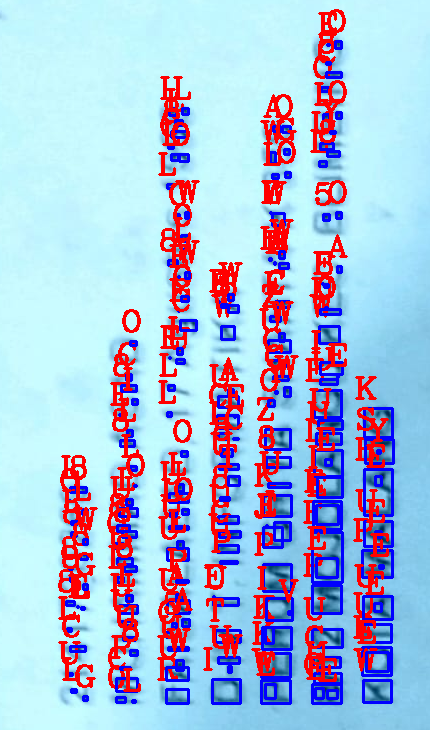

In [163]:
process_ktm_image(ktm_crop12, load_network, char_list)

# Test Citra KTM 13

Jumlah Piksel Baris: 1014
Jumlah Piksel Kolom: 1600


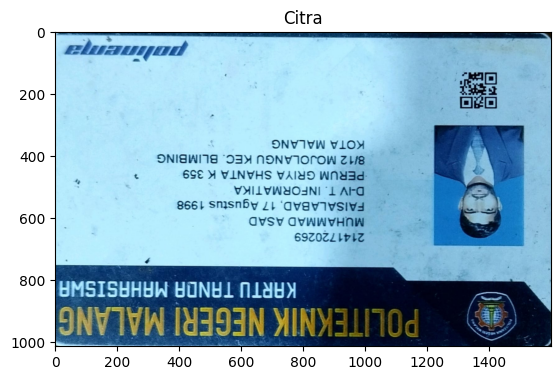

In [164]:
ktm_image_path13 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3I_2141720269_3 - Muhammad Asad.jpeg')
height, width = ktm_image_path13.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path13, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

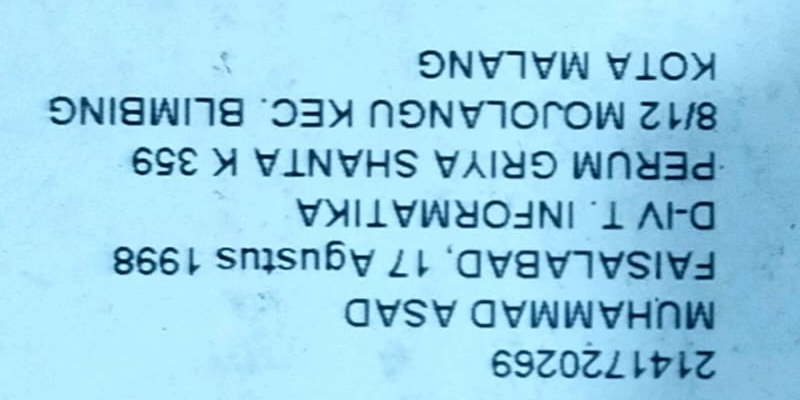

In [168]:
ktm_crop13 = ktm_image_path13[300:700,280:1080]
cv2_imshow(ktm_crop13)

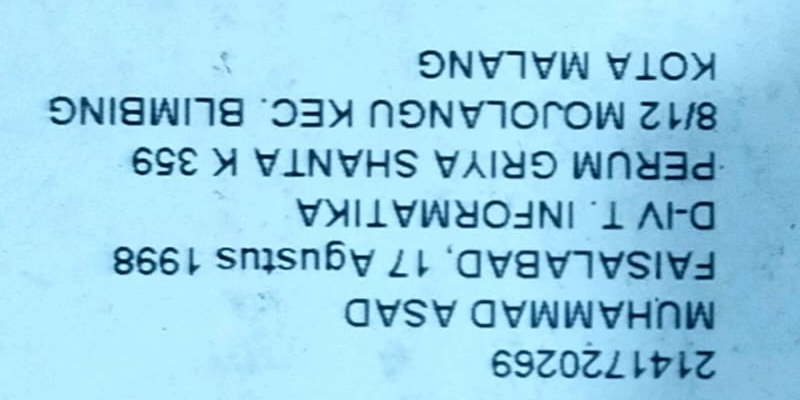

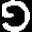

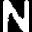

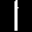

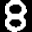

...

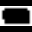

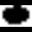

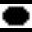

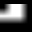

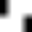

6/6 [==============================] - 0s 30ms/step


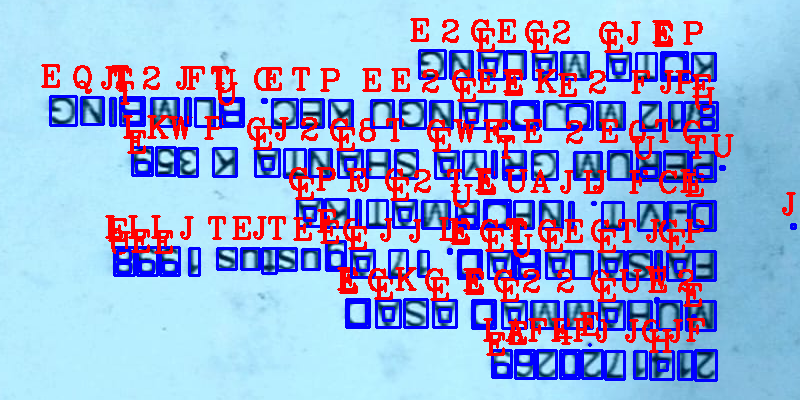

In [169]:
process_ktm_image(ktm_crop13, load_network, char_list)

# Test Citra KTM 14

Jumlah Piksel Baris: 1600
Jumlah Piksel Kolom: 1027


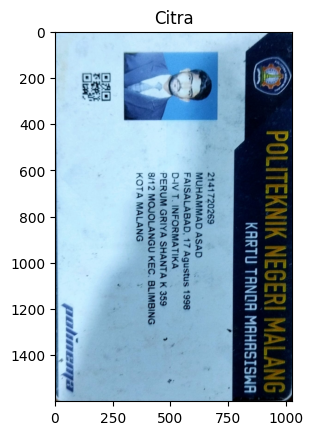

In [170]:
ktm_image_path14 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3I_2141720268_4 - Muhammad Asad.jpeg')
height, width = ktm_image_path14.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path14, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

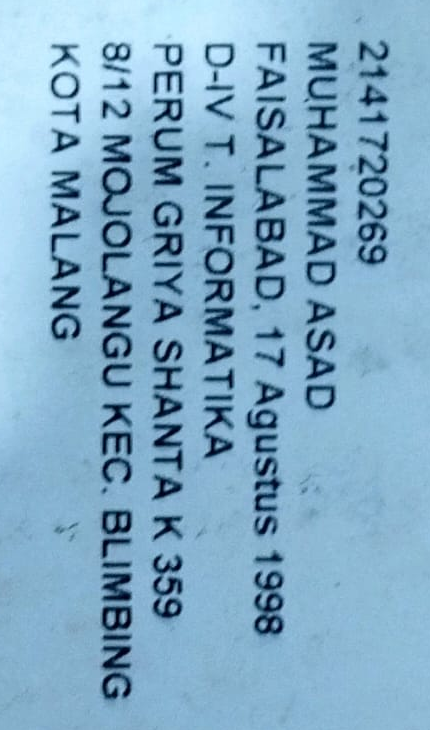

In [172]:
ktm_crop14 = ktm_image_path14[570:1300,300:730]
cv2_imshow(ktm_crop14)

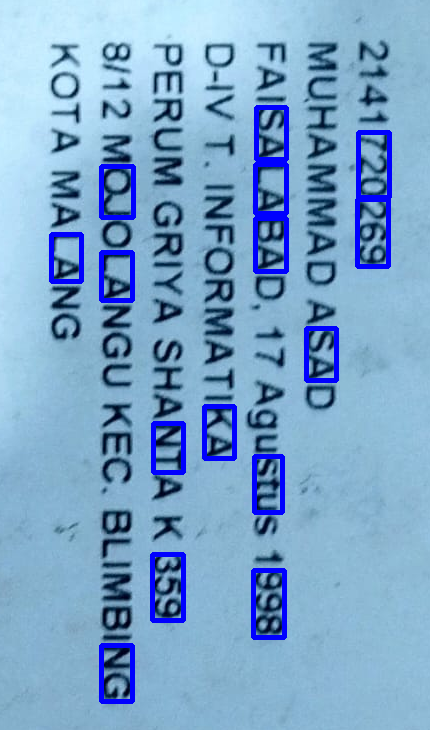

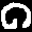

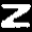

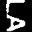

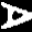

...

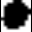

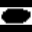

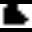

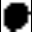

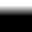

6/6 [==============================] - 0s 24ms/step


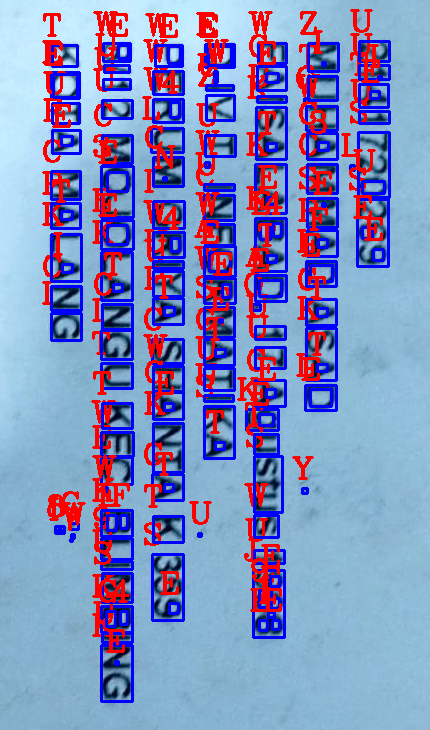

In [173]:
process_ktm_image(ktm_crop14, load_network, char_list)

# Test Citra KTM 15

Jumlah Piksel Baris: 362
Jumlah Piksel Kolom: 696


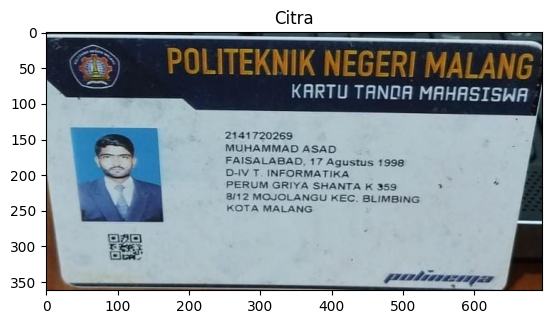

In [174]:
ktm_image_path15 = cv.imread('/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3I_2141720269_5 - Muhammad Asad.jpeg')
height, width = ktm_image_path15.shape[:2]
print(f'Jumlah Piksel Baris: {height}')
print(f'Jumlah Piksel Kolom: {width}')
plt.imshow(cv.cvtColor(ktm_image_path15, cv.COLOR_BGR2RGB))
plt.title('Citra')
plt.show()

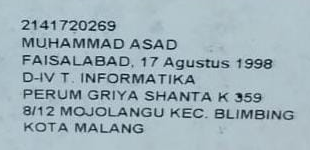

In [176]:
ktm_crop15 = ktm_image_path15[120:270,230:540]
cv2_imshow(ktm_crop15)

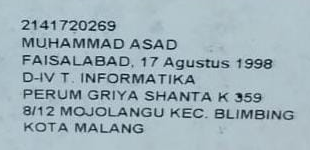

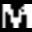

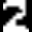

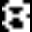

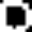

...

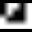

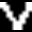

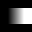

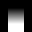

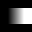

6/6 [==============================] - 0s 3ms/step


In [177]:
process_ktm_image(ktm_crop15, load_network, char_list)